## Calibrating Camera and Superimposing an Object on the Calibration Pattern
Authors: Marco Zullich and Domagoj Korais


### Step 0 loading images and libraries, estimate homographies.

In [3]:
#already imports numpy as np, cv2, matplotlib.pyplot 
#as py, os
from CameraCalibration import *
import drawingHelper as dh



#load all webcam images 
webcam = importImagesFolder('../images_calib_custom/')
#load fisheye images
fisheye = importImagesFolder('../reflex_images/fisheye/')
#choose wich one to show
imgs=fisheye

print("Number of loaded images: ", len(imgs))
#check example of loaded image
plt.figure(figsize=(15, 7))
imgplot = plt.imshow(imgs[0])

Number of loaded images:  28


Board found in every image?  True


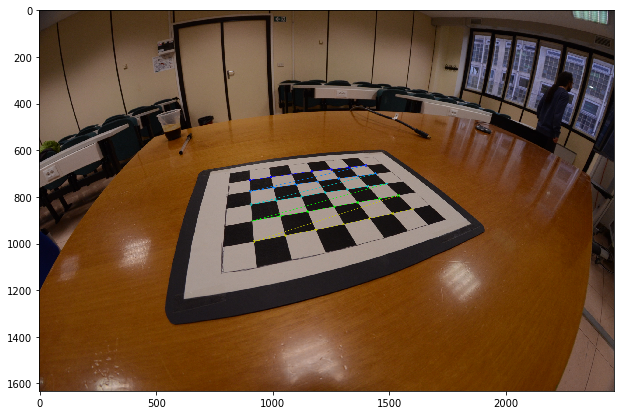

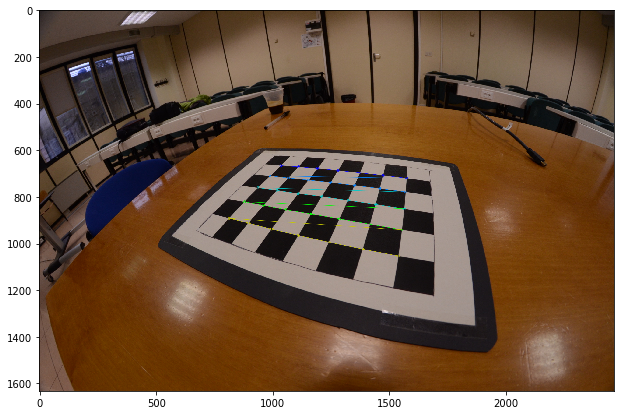

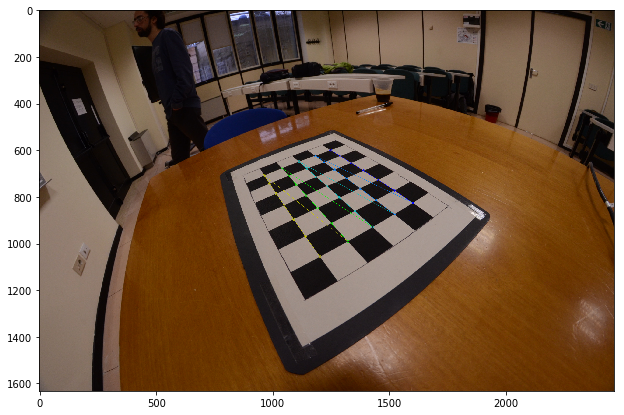

In [5]:
#detect checkerboard crossings and store object/image points
checkerboardSize = (7,5)
imgs_check, objpoints, imgpoints, checkerFound = \
    detectAndSaveCheckerboardInList(imgs, checkerboardSize)

#Check if it found the board in every input image
print("Board found in every image? ",all(item == True for item in checkerFound))

#check if detection was succesfull on a subset of images
for i in range(0,3):
    plt.figure(figsize=(15, 7))
    imgplot = plt.imshow(imgs_check[i])

## Step 1 Calibrate using Zhang procedure 

In [6]:
ret, mtx, dist, rvecs, tvecs = calibrateCamera(objpoints, imgpoints, imgs_check[0].shape[0:2],
               False)

In [7]:
print("OpenCv's error:\n ",ret,"\n")

print("Intrinsic parameters:\n  ",mtx,"\n")
print("Distortion coefficients:\n  ",dist,"\n")
#convert from rotation vector to rotation matrix
rotationMatrixes = []
for rotationVector in rvecs:
    rot,_=cv2.Rodrigues(rotationVector)
    rotationMatrixes.append(rot)
print("R:\n  ", rotationMatrixes,"\n")
print("T:\n  ", tvecs,"\n")

OpenCv's error:
  10.09708797736103 

Intrinsic parameters:
   [[8.00519863e+02 0.00000000e+00 1.25710610e+03]
 [0.00000000e+00 7.97583267e+02 8.41329634e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]] 

Distortion coefficients:
   [[0. 0. 0. 0. 0.]] 

R:
   [array([[ 0.93740606,  0.34397947, -0.05429548],
       [-0.17042312,  0.58911172,  0.78987552],
       [ 0.30368707, -0.73118089,  0.61085896]]), array([[ 0.9420708 , -0.32381301,  0.08745136],
       [ 0.15014745,  0.64027435,  0.75332895],
       [-0.29993057, -0.69655861,  0.65180347]]), array([[ 0.52256608, -0.84652613,  0.10157859],
       [ 0.52432388,  0.41302203,  0.74464573],
       [-0.67231626, -0.33586652,  0.65968517]]), array([[ 0.01126608,  0.99958475, -0.02652158],
       [-0.68479702,  0.02704006,  0.72823202],
       [ 0.72864677,  0.00995758,  0.6848173 ]]), array([[ 0.88207628, -0.46846387,  0.04983012],
       [ 0.23528566,  0.5297021 ,  0.81489652],
       [-0.4081447 , -0.70707658,  0.57746049]]), arra

## Step 2 Computing total reprojection error 

In [8]:
#calculate geometric reprojection error based on lecture slides
#(residual sum of squares) for all calibration images
repError, projPoints = computeReprojectionError(imgpoints, objpoints, rvecs,
                        tvecs, mtx, dist)

print("Reprojection errors: ",repError,"\n")
print("Mean error:",np.mean(repError))
print("Standard deviation:",np.std(repError))

Reprojection errors:  [591.24603, 779.9644, 198.72293, 562.41766, 451.37405, 1201.0433, 1031.0648, 327.42453, 724.7167, 1081.5852, 230.69026, 2840.0007, 1770.0511, 252.75398, 1313.838, 1088.5226, 1553.3785, 476.71844, 1389.8704, 6432.1016, 21284.19, 4722.3325, 2100.2634, 3068.7598, 6927.79, 4406.999, 14910.879, 18193.467] 

Mean error: 3568.2917
Standard deviation: 5409.576


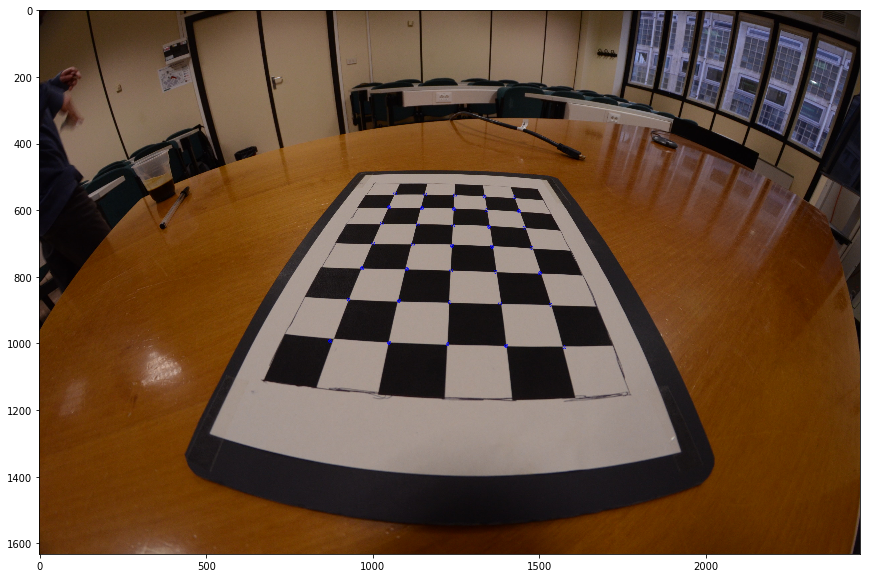

In [9]:
#image with reprojected points
img_index = 3
if checkerFound[img_index]:
    img2_copy = np.copy(imgs[img_index])
    cv2.drawChessboardCorners(img2_copy, checkerboardSize,
                              projPoints[img_index], False)
    plt.figure(figsize=(25, 10))
    plt.imshow(img2_copy)
else:
    print("The image with index " + str(img_index) + " has no checkerboard detected in it.")

## Step 3 Add radial distortion compensation

In [10]:
#calibrate camera using cv2 function - this will return a
#slightly different version of distortion coefficients
#than the one seen during lectures: this one considers also
#a third coefficient k3

ret, mtx, dist, rvecs, tvecs = calibrateCamera(
    objpoints, imgpoints, imgs_check[0].shape[0:2], True)

print("OpenCv's error:\n ",ret,"\n")

print("Intrinsic parameters:\n  ",mtx,"\n")
print("Distortion coefficients:\n  ",dist,"\n")
print("R:\n  ", rvecs,"\n")
print("T:\n  ", tvecs,"\n")

OpenCv's error:
  0.6984034125340846 

Intrinsic parameters:
   [[8.73243444e+02 0.00000000e+00 1.23027941e+03]
 [0.00000000e+00 8.72983547e+02 8.36450882e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]] 

Distortion coefficients:
   [[-0.27393883  0.10570782  0.          0.         -0.02188823]] 

R:
   [array([[-0.92038736],
       [-0.19074037],
       [-0.28744766]]), array([[-0.8604206 ],
       [ 0.25005025],
       [ 0.28621745]]), array([[-0.72425585],
       [ 0.55086887],
       [ 0.92170947]]), array([[-0.65731582],
       [-0.64696462],
       [-1.43384785]]), array([[-0.93888694],
       [ 0.30709737],
       [ 0.4413677 ]]), array([[-0.82698092],
       [-0.2111581 ],
       [-0.47626034]]), array([[-0.65125584],
       [-0.70677732],
       [-1.42596976]]), array([[-0.47745383],
       [-0.45949949],
       [-1.45652459]]), array([[-0.32718787],
       [-0.09596198],
       [-0.51581044]]), array([[-0.36418347],
       [ 0.25313331],
       [ 0.34035406]]), array([[

## Step 4 Error's comparison

In [13]:
#reprojection error considering radial distortion
repError_dist, projPoints_dist = computeReprojectionError(imgpoints, objpoints, rvecs,
                        tvecs, mtx, dist)

print("Reprojection errors: ",repError_dist,"\n")
print("Mean error:",np.mean(repError_dist))
print("Standard deviation:",np.std(repError_dist))

Reprojection errors:  [12.456484, 11.493725, 11.148658, 19.241436, 11.684251, 18.03646, 17.434338, 5.85443, 6.34847, 7.6345463, 9.670576, 28.060734, 18.55896, 3.9689994, 14.587847, 18.358978, 20.111298, 8.801912, 19.309757, 14.992755, 32.780365, 19.326267, 12.602397, 18.58103, 21.999157, 17.534044, 28.559856, 48.873486] 

Mean error: 17.071829
Standard deviation: 9.138425


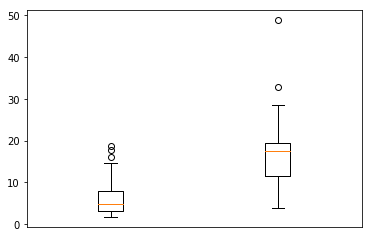

In [18]:
#from pylab import 
repError_dist_norm_wc = [5.511035,
 2.9881763,
 18.72798,
 7.9041724,
 14.664401,
 16.03681,
 4.0964932,
 8.037931,
 5.4475827,
 17.686163,
 1.7647939,
 4.136373,
 1.9074647,
 4.716319,
 3.2830207,
 3.1335957,
 1.617566]
#repError_df = np.column_stack([repError_dist_norm_wc, repError_dist])
bpt_dist, ax = plt.subplots(1)
ax.boxplot([repError_dist_norm_wc, repError_dist])
ax.axes.get_xaxis().set_visible(False)
plt.show()

In [9]:
#percentage variation of reprojection error from calibration
#without and with radial distortion
[(x-y)/y for x,y in zip(repError_dist, repError)]

[-0.9580798,
 -0.96578795,
 -0.9939451,
 -0.9976691,
 -0.98610675,
 -0.98313403,
 -0.99011946,
 -0.98498267,
 -0.98705316,
 -0.9973137,
 -0.9968245,
 -0.974114,
 -0.989515,
 -0.9959075,
 -0.99808466,
 -0.9984598,
 -0.9888967,
 -0.9852638,
 -0.9929414,
 -0.99399966,
 -0.98429704,
 -0.9912401,
 -0.98309094,
 -0.98211974,
 -0.9438985,
 -0.9789317,
 -0.9960213,
 -0.9815363]

## Step 5 cylinder superposition

/home/doma/.venvs/computer_vision/lib/python3.5/site-packages/matplotlib/pyplot.py:513: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


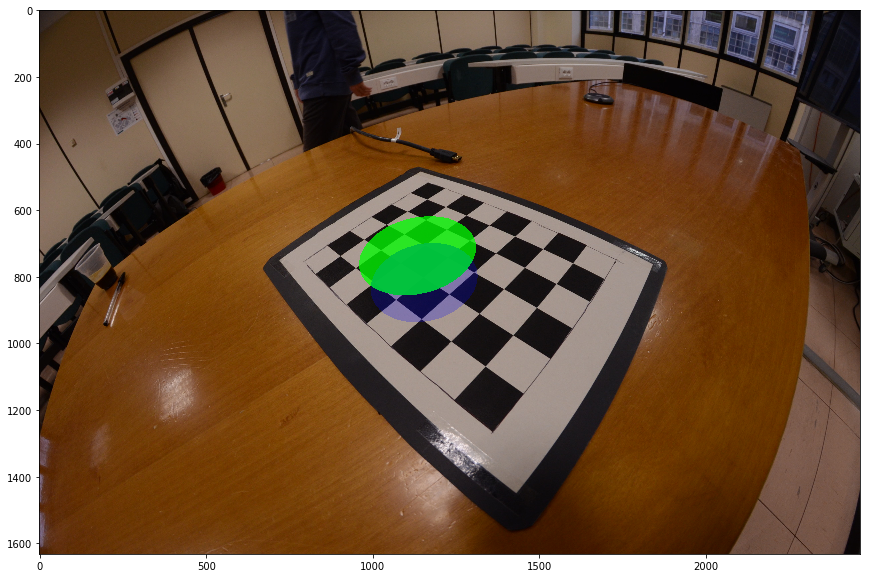

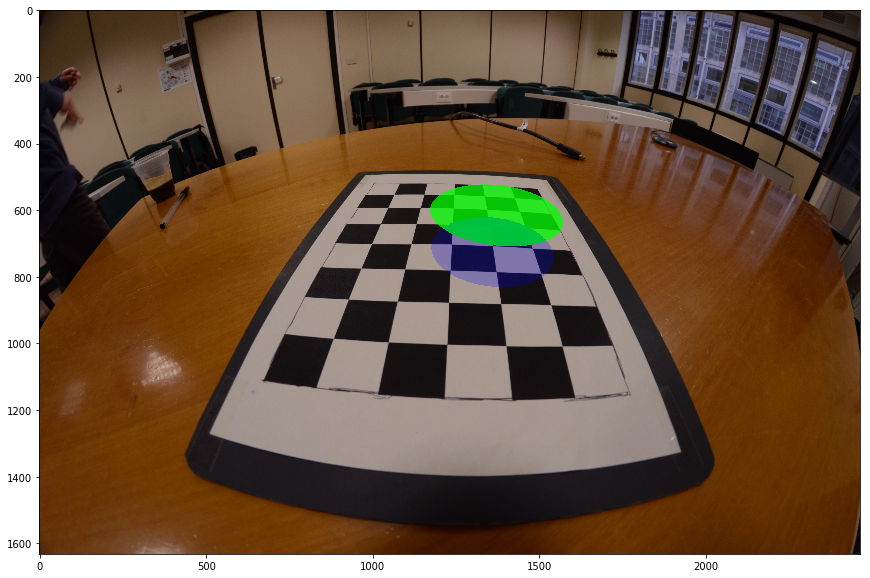

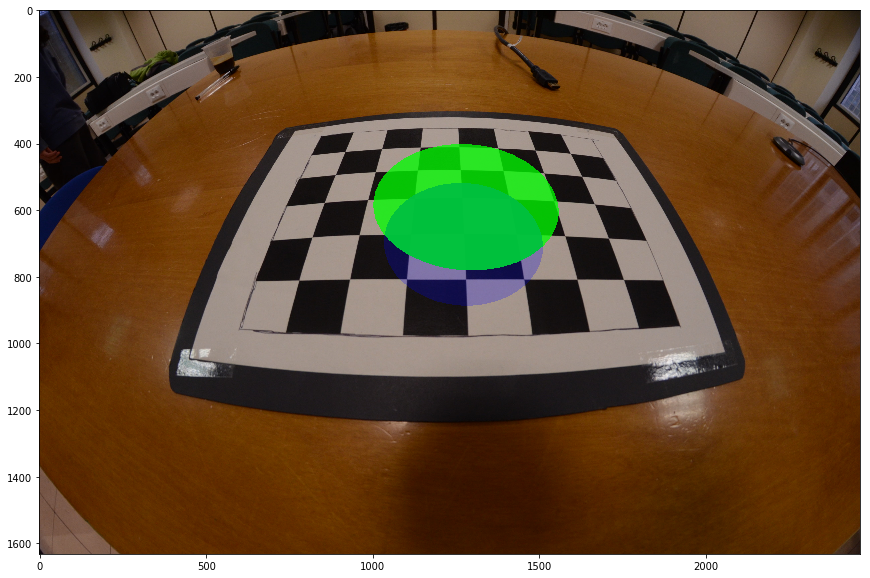

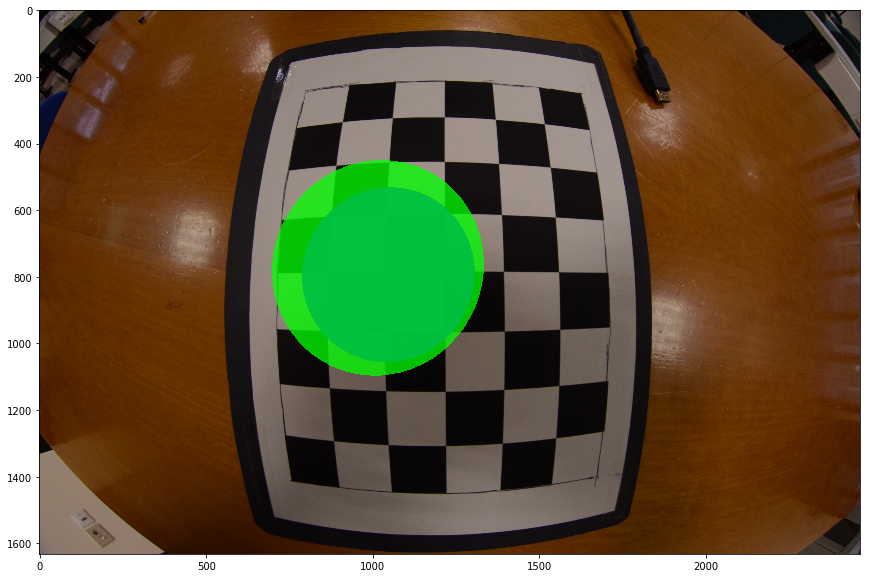

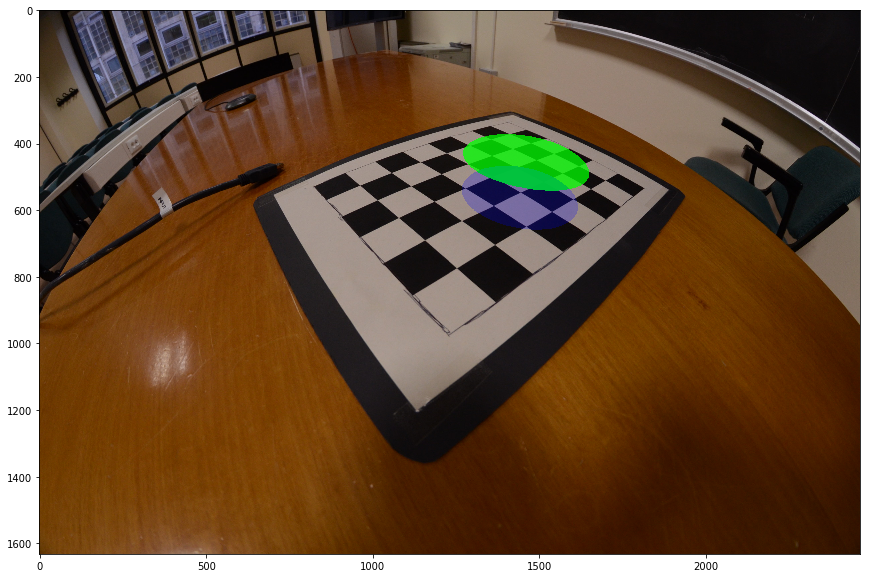

...

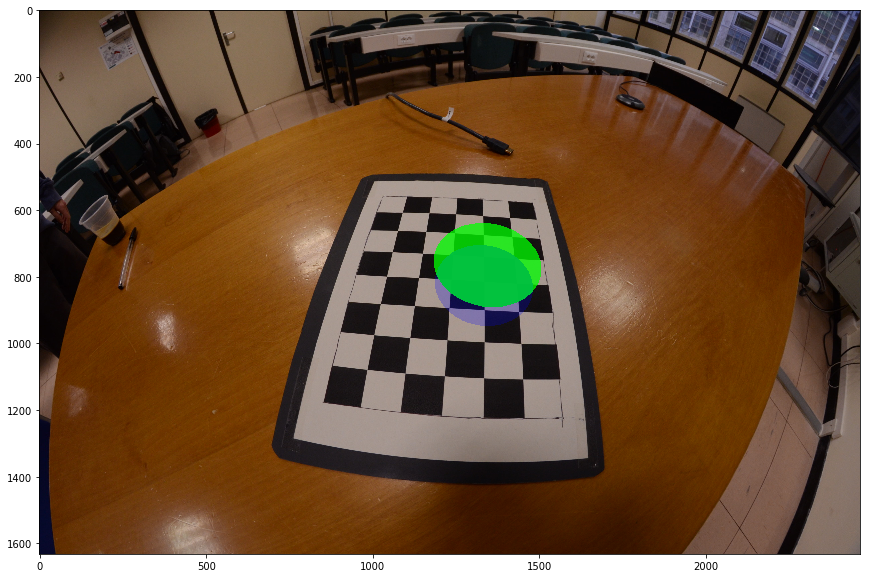

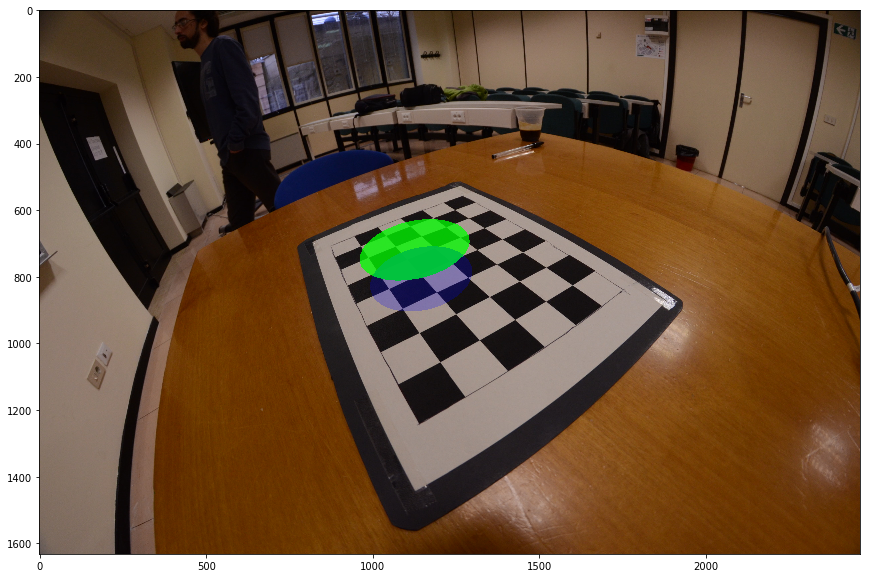

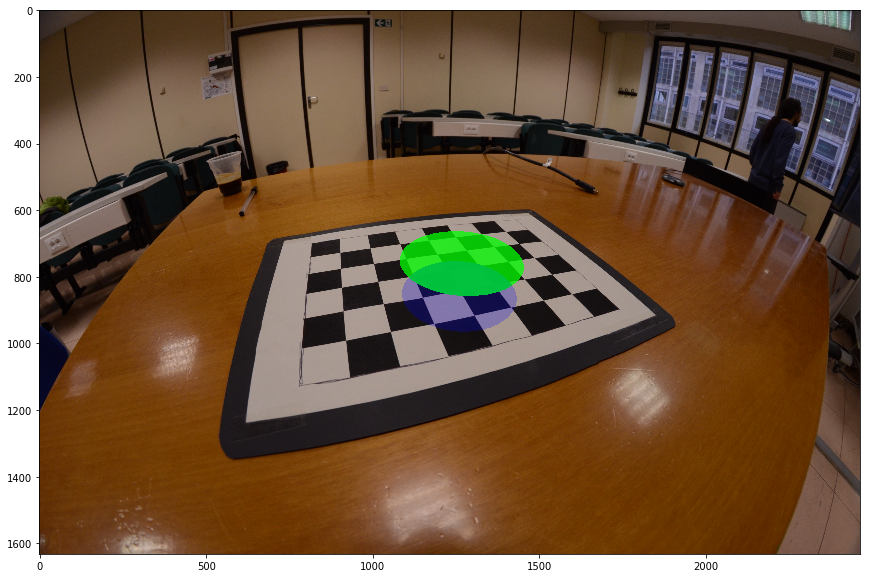

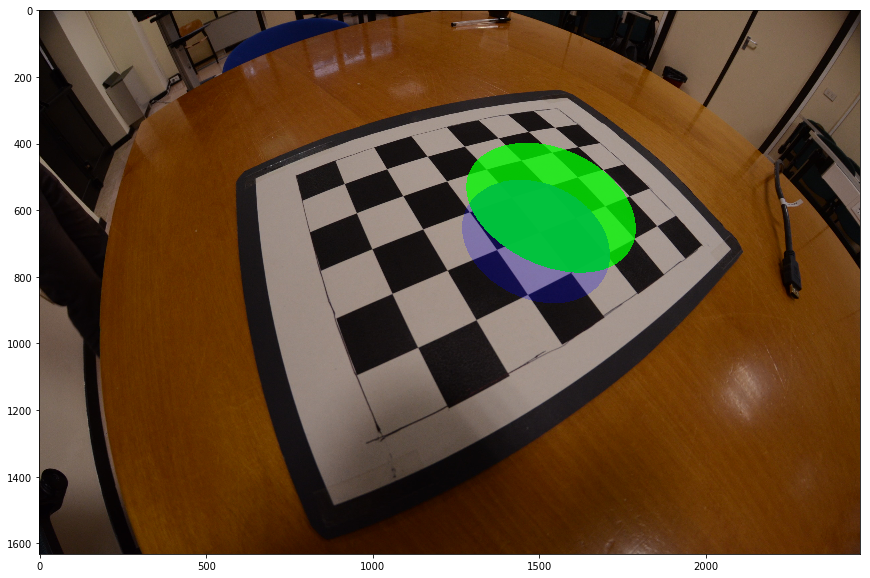

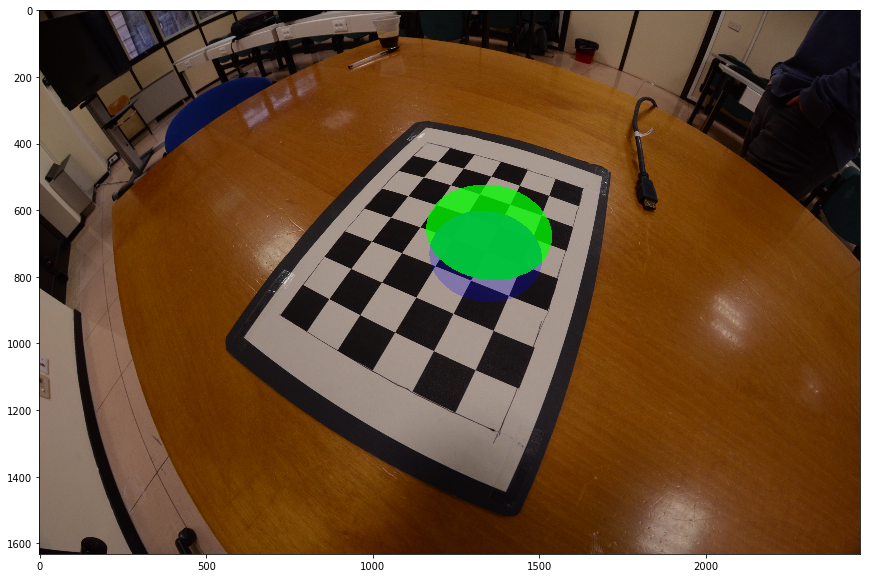

In [10]:
for i in range(len(imgs)):
    img_ind=i;
    if checkerFound[img_ind]:
        img = dh.draw_solid('Cylinder', (1.5,1), (3,3), imgs[img_ind], imgpoints[img_ind], mtx, rvecs[img_ind],
                            tvecs[img_ind], dist)
        plt.figure(figsize=(25, 10))
        imgplot = plt.imshow(img)
    else:
        print("Checkerboard pattern not found in image with index " + str(img_ind))